<a href="https://colab.research.google.com/github/Tucker925H/tennisAIvision/blob/main/Tennis_Classification_git.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
!apt-get -y install fonts-ipafont-gothic
!pip install japanize-matplotlib
import japanize_matplotlib

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  fonts-ipafont-mincho
The following NEW packages will be installed:
  fonts-ipafont-gothic fonts-ipafont-mincho
0 upgraded, 2 newly installed, 0 to remove and 9 not upgraded.
Need to get 8,237 kB of archives.
After this operation, 28.7 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 fonts-ipafont-gothic all 00303-21ubuntu1 [3,513 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 fonts-ipafont-mincho all 00303-21ubuntu1 [4,724 kB]
Fetched 8,237 kB in 2s (5,297 kB/s)
Selecting previously unselected package fonts-ipafont-gothic.
(Reading database ... 120880 files and directories currently installed.)
Preparing to unpack .../fonts-ipafont-gothic_00303-21ubuntu1_all.deb ...
Unpacking fonts-ipafont-gothic (00303-21ubuntu1) ...
Selecting previously unselected package fonts-ipaf

# YOLOv8を使った骨格検出
---
説明

In [ ]:
pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 645.2/645.2 kB 9.0 MB/s eta 0:00:00


In [ ]:
import cv2
from ultralytics import YOLO

# モデルの読み込み。姿勢推論用のモデルデータを読み込む
model = YOLO('yolov8n-pose.pt')

# 本体のウェブカメラからキャプチャする設定
video_path = 0 # 本体に付属のカメラを指定
capture = cv2.VideoCapture(video_path)

while capture.isOpened():
	success, frame = capture.read()
	if success:
		# 推論を実行
		results = model(frame)

		annotatedFrame = results[0].plot()
		cv2.imshow("YOLOv8 Inference", annotatedFrame)

		# 検出オブジェクトの名前、バウンディングボックス座標を取得
		names = results[0].names
		classes = results[0].boxes.cls
		boxes = results[0].boxes

		for box, cls in zip(boxes, classes):
			name = names[int(cls)]
			x1, y1, x2, y2 = [int(i) for i in box.xyxy[0]]

		if len(results[0].keypoints) == 0:
			continue

		# 姿勢分析結果のキーポイントを取得する
		keypoints = results[0].keypoints
		for keypoint in keypoints[0]:
			print(f"Keypoint X={int(keypoint[0])}, Y={int(keypoint[1])}, Score={keypoint[2]:.4}")

		if cv2.waitKey(1) & 0xFF == ord("q"):
			break
	else:
		break

capture.release()
cv2.destroyAllWindows

100%|██████████| 6.51M/6.51M [00:00<00:00, 53.8MB/s]


<function destroyAllWindows>

In [ ]:
import cv2
import os
from ultralytics import YOLO

def process_images(input_path, output_path):
    """
    画像に骨格検出モデルを適用し、結果を保存する関数。

    Parameters:
    - input_path: 画像ファイルが格納されているディレクトリのパス。
    - output_path: 結果を保存するディレクトリのパス。

    Returns:
    - results_list: 各画像の結果を格納するリスト。
    """

    # モデルの読み込み
    model = YOLO("yolov8n-pose.pt")

    # 指定されたディレクトリ内のすべての画像ファイルのリストを取得
    image_files = [f for f in os.listdir(input_directory) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    # 各画像の結果を格納するリスト
    results_list = []

    for image_file in image_files:
        # 画像の読み込み
        frame = cv2.imread(os.path.join(input_path, image_file))

        # モデルの適用
        result = model(frame)

        # 結果をresults_listリストに追加
        results_list.append(result)

        # 結果の保存
        plotted_frame = result[0].plot()
        output_file = os.path.join(output_path, "result_" + image_file)
        cv2.imwrite(output_file, plotted_frame)

    return results_list

In [ ]:
kind_shots = ["smash", "backslice", "backhand-topspin", "serve", "forehand-topspin", "forehand-volley", "backhand-volley", "flat_in", "slice_in", "spin_in", "spin_in2"]
serve_shots = ["flat_in", "slice_in", "spin_in"]
shots = {"smash", "forehand"}
shots2 = {"backhand", "forevolly", "backvolly"}
results = {}

In [ ]:
for shot in shots:
    input_directory = f"/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/input/shots_variable/{shot}/"
    output_directory = f"/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/output/shots/{shot}"
    results[shot] = process_images(input_directory, output_directory)


0: 640x384 1 person, 182.2ms
Speed: 17.6ms preprocess, 182.2ms inference, 45.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 person, 14.6ms
Speed: 3.2ms preprocess, 14.6ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 person, 32.7ms
Speed: 5.5ms preprocess, 32.7ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 person, 16.6ms
Speed: 3.3ms preprocess, 16.6ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 person, 14.3ms
Speed: 3.3ms preprocess, 14.3ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 person, 15.3ms
Speed: 4.1ms preprocess, 15.3ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 person, 11.7ms
Speed: 3.2ms preprocess, 11.7ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 person, 9.9ms
Speed: 3.3ms preprocess, 9.9ms inference, 2.1ms postprocess per image at shape (1, 3, 

In [ ]:
import pandas as pd
columns_name = ['L_Shoulder_X', 'R_Shoulder_X', 'L_Elbow_X', 'R_Elbow_X', 'L_Wrist_X', 'R_Wrist_X', 'L_Shoulder_Y', 'R_Shoulder_Y', 'L_Elbow_Y', 'R_Elbow_Y', 'L_Wrist_Y', 'R_Wrist_Y', 'shot']
all_columns_name = ['Nose_X', 'L_Eye_X', 'R_Eye_X', 'L_Ear_X', 'R_Ear_X', 'L_Shoulder_X', 'R_Shoulder_X', 'L_Elbow_X', 'R_Elbow_X', 'L_Wrist_X', 'R_Wrist_X', 'L_Waist_X', 'R_Waist_X', 'L_Knee_X', "R_Knee_X", 'L_Ankle_X', 'R_Ankle_X', 'Nose_Y', 'L_Eye_Y', 'R_Eye_Y', 'L_Ear_Y', 'R_Ear_Y', 'L_Shoulder_Y', 'R_Shoulder_Y', 'L_Elbow_Y', 'R_Elbow_Y', 'L_Wrist_Y', 'R_Wrist_Y', 'L_Waist_Y', 'R_Waist_Y', 'L_Knee_Y', "R_Knee_Y", 'L_Ankle_Y', 'R_Ankle_Y', 'shot']
unknown_columns_name = ['Nose_X', 'L_Eye_X', 'R_Eye_X', 'L_Ear_X', 'R_Ear_X', 'L_Shoulder_X', 'R_Shoulder_X', 'L_Elbow_X', 'R_Elbow_X', 'L_Wrist_X', 'R_Wrist_X', 'L_Waist_X', 'R_Waist_X', 'L_Knee_X', "R_Knee_X", 'L_Ankle_X', 'R_Ankle_X', 'Nose_Y', 'L_Eye_Y', 'R_Eye_Y', 'L_Ear_Y', 'R_Ear_Y', 'L_Shoulder_Y', 'R_Shoulder_Y', 'L_Elbow_Y', 'R_Elbow_Y', 'L_Wrist_Y', 'R_Wrist_Y', 'L_Waist_Y', 'R_Waist_Y', 'L_Knee_Y', "R_Knee_Y", 'L_Ankle_Y', 'R_Ankle_Y']

In [ ]:
lists = []
for shot in shots:
  # TensorをCPUに移動してから.numpy()を呼び出す
  x_coords = [linear_interpolation(result[0].keypoints.xyn[0][:, 0].cpu().numpy()) for result in results[shot]]
  y_coords = [linear_interpolation(result[0].keypoints.xyn[0][:, 1].cpu().numpy()) for result in results[shot]]
  num_images = len(results[shot])
  for i in range(num_images):
    sub_list = []  # Create a new sublist for each iteration of i
    for j in range(17):
        sub_list.append(x_coords[i][j])
        sub_list.append(y_coords[i][j])
    sub_list.append(shot)
    lists.append(sub_list)  # Append the sublist to the main list

# pandasのDataFrameを作成する
data = pd.DataFrame(data=lists, columns=all_columns_name)
data

,Nose_X,L_Eye_X,R_Eye_X,L_Ear_X,R_Ear_X,L_Shoulder_X,R_Shoulder_X,L_Elbow_X,R_Elbow_X,L_Wrist_X,...,R_Elbow_Y,L_Wrist_Y,R_Wrist_Y,L_Waist_Y,R_Waist_Y,L_Knee_Y,R_Knee_Y,L_Ankle_Y,R_Ankle_Y,shot
0,0.413338,0.550022,0.413338,0.550022,0.413338,0.550022,0.413338,0.550022,0.413338,0.550022,...,0.634182,0.418041,0.701220,0.473180,0.693211,0.425673,0.752891,0.486145,0.752900,smash
1,0.629857,0.531027,0.625934,0.531574,0.622010,0.532121,0.618087,0.532669,0.614164,0.533216,...,0.623753,0.631358,0.693816,0.598796,0.689119,0.636314,0.741989,0.559270,0.734555,smash
2,0.496191,0.528403,0.500069,0.525391,0.489047,0.524628,0.505645,0.531020,0.477746,0.529492,...,0.615981,0.499646,0.673479,0.454218,0.653503,0.498795,0.715524,0.442154,0.684977,smash
3,0.513167,0.492303,0.518936,0.488969,0.508542,0.487755,0.525707,0.495038,0.499423,0.491250,...,0.583052,0.521467,0.634096,0.471562,0.630628,0.523840,0.679556,0.461303,0.675811,smash
4,0.573180,0.493011,0.578120,0.490375,0.567911,0.489890,0.584893,0.497041,0.560827,0.495114,...,0.573567,0.566505,0.628206,0.526039,0.616275,0.574671,0.670734,0.518456,0.655316,smash
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
135,0.520779,0.490365,0.518814,0.487929,0.516848,0.485492,0.514173,0.487443,0.511497,0.489393,...,0.589297,0.542862,0.658246,0.554660,0.656971,0.533312,0.713919,0.524901,0.716094,smash
136,0.679052,0.602725,0.681963,0.607550,0.684873,0.612375,0.687784,0.617200,0.690695,0.622025,...,0.707863,0.758624,0.756140,0.723431,0.771114,0.750445,0.801825,0.687588,0.827711,smash
137,0.463414,0.462240,0.463414,0.462240,0.463414,0.462240,0.463414,0.462240,0.458141,0.472280,...,0.558036,0.457602,0.610733,0.525445,0.608506,0.456876,0.661634,0.561563,0.659610,smash
138,0.551193,0.484296,0.548473,0.482777,0.545753,0.481258,0.537709,0.485023,0.529665,0.488787,...,0.588118,0.542408,0.658468,0.525610,0.660293,0.545727,0.715095,0.483714,0.717958,smash


In [ ]:
data.to_csv("/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/csv_data/smash_variable.csv", index=False)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and 

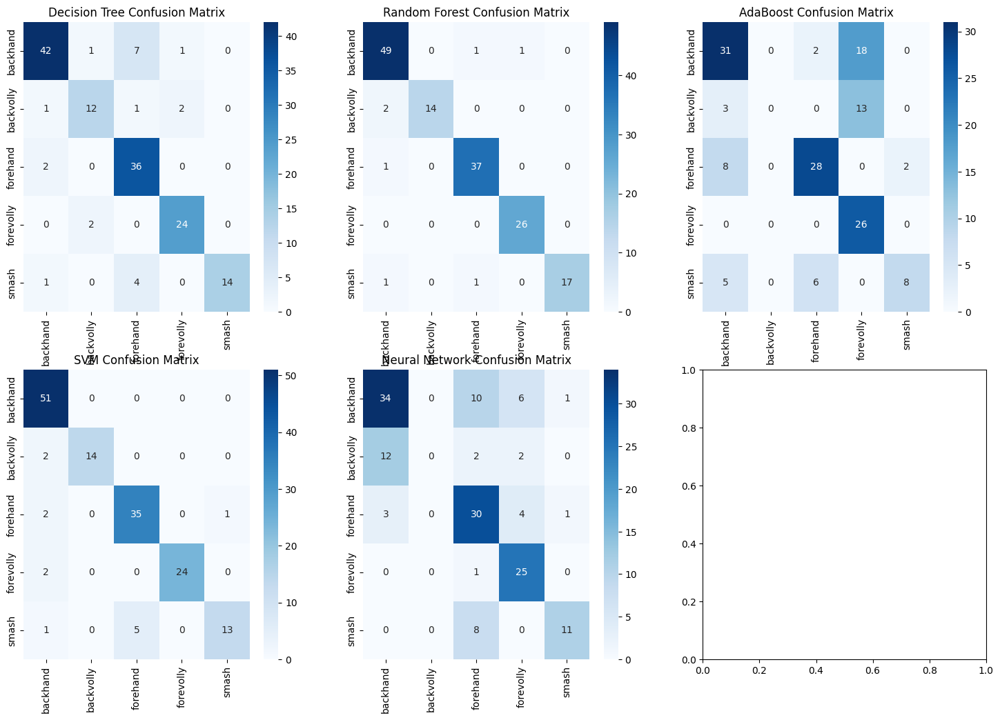

Decision Tree Model Report:
              precision    recall  f1-score   support

           0       0.91      0.82      0.87        51
           1       0.80      0.75      0.77        16
           2       0.75      0.95      0.84        38
           3       0.89      0.92      0.91        26
           4       1.00      0.74      0.85        19

    accuracy                           0.85       150
   macro avg       0.87      0.84      0.85       150
weighted avg       0.87      0.85      0.85       150


Random Forest Model Report:
              precision    recall  f1-score   support

           0       0.92      0.96      0.94        51
           1       1.00      0.88      0.93        16
           2       0.95      0.97      0.96        38
           3       0.96      1.00      0.98        26
           4       1.00      0.89      0.94        19

    accuracy                           0.95       150
   macro avg       0.97      0.94      0.95       150
weighted avg       0

In [ ]:
# 必要なライブラリのインポート
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.svm import SVC  # 追加：SVMのインポート
from sklearn.neural_network import MLPClassifier  # 追加：ニューラルネットワークのインポート
from sklearn.metrics import classification_report, confusion_matrix

# データの読み込み
url = "/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/csv_data/shots.csv"
data = pd.read_csv(url)

# 特徴量とターゲットにデータを分割
X = data.drop('shot', axis=1)
y = data['shot']

# ラベルを数値にエンコード
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# 訓練セットとテストセットに分割
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42)

# モデルを初期化
dt_classifier = DecisionTreeClassifier(random_state=42)
rf_classifier = RandomForestClassifier(random_state=42)
ab_classifier = AdaBoostClassifier(random_state=42)
svm_classifier = SVC(random_state=42)  # 追加：SVMの初期化
nn_classifier = MLPClassifier(random_state=42)  # 追加：ニューラルネットワークの初期化

# モデルを訓練
dt_classifier.fit(X_train, y_train)
rf_classifier.fit(X_train, y_train)
ab_classifier.fit(X_train, y_train)
svm_classifier.fit(X_train, y_train)  # 追加：SVMの訓練
nn_classifier.fit(X_train, y_train)  # 追加：ニューラルネットワークの訓練

# テストセットでモデルを評価
dt_predictions = dt_classifier.predict(X_test)
rf_predictions = rf_classifier.predict(X_test)
ab_predictions = ab_classifier.predict(X_test)
svm_predictions = svm_classifier.predict(X_test)  # 追加：SVMの評価
nn_predictions = nn_classifier.predict(X_test)  # 追加：ニューラルネットワークの評価

# ラベルを数値にエンコード
class_names = label_encoder.classes_

# 評価結果を表示
dt_report = classification_report(y_test, dt_predictions)
rf_report = classification_report(y_test, rf_predictions)
ab_report = classification_report(y_test, ab_predictions)
svm_report = classification_report(y_test, svm_predictions)  # 追加：SVMの評価レポート
nn_report = classification_report(y_test, nn_predictions)  # 追加：ニューラルネットワークの評価レポート

# 混合行列を計算
dt_cm = confusion_matrix(y_test, dt_predictions)
rf_cm = confusion_matrix(y_test, rf_predictions)
ab_cm = confusion_matrix(y_test, ab_predictions)
svm_cm = confusion_matrix(y_test, svm_predictions)  # 追加：SVMの混合行列
nn_cm = confusion_matrix(y_test, nn_predictions)  # 追加：ニューラルネットワークの混合行列

# 混合行列のヒートマップを描画
fig, axes = plt.subplots(2, 3, figsize=(18, 12))
sns.heatmap(dt_cm, annot=True, fmt="d", ax=axes[0, 0], cmap="Blues", xticklabels=class_names, yticklabels=class_names)
sns.heatmap(rf_cm, annot=True, fmt="d", ax=axes[0, 1], cmap="Blues", xticklabels=class_names, yticklabels=class_names)
sns.heatmap(ab_cm, annot=True, fmt="d", ax=axes[0, 2], cmap="Blues", xticklabels=class_names, yticklabels=class_names)
sns.heatmap(svm_cm, annot=True, fmt="d", ax=axes[1, 0], cmap="Blues", xticklabels=class_names, yticklabels=class_names)  # 追加：SVMの混合行列
sns.heatmap(nn_cm, annot=True, fmt="d", ax=axes[1, 1], cmap="Blues", xticklabels=class_names, yticklabels=class_names)  # 追加：ニューラルネットワークの混合行列
axes[0, 0].set_title('Decision Tree Confusion Matrix')
axes[0, 1].set_title('Random Forest Confusion Matrix')
axes[0, 2].set_title('AdaBoost Confusion Matrix')
axes[1, 0].set_title('SVM Confusion Matrix')  # 追加：SVMの混合行列
axes[1, 1].set_title('Neural Network Confusion Matrix')  # 追加：ニューラルネットワークの混合行列
plt.show()

# 評価レポートを表示
print("Decision Tree Model Report:")
print(dt_report)
print("\nRandom Forest Model Report:")
print(rf_report)
print("\nAdaBoost Model Report:")
print(ab_report)
print("\nSVM Model Report:")  # 追加：SVMの評価レポート
print(svm_report)
print("\nNeural Network Model Report:")  # 追加：ニューラルネットワークの評価レポート
print(nn_report)


In [ ]:
import pandas as pd

def create_dataframe_from_keypoints(results, unknown_columns_name):
    lists = []
    x_coords = [linear_interpolation(result[0].keypoints.xyn[0][:, 0].numpy()) for result in results]
    y_coords = [linear_interpolation(result[0].keypoints.xyn[0][:, 1].numpy()) for result in results]
    for j in range(17):  # Assuming there are 17 keypoints per image
        lists.append(x_coords[0][j])
        lists.append(y_coords[0][j])

    # Create the DataFrame
    data = pd.DataFrame(data=lists, columns=unknown_columns_name)
    return data

In [ ]:
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
from skimage import io  # scikit-imageを使用して画像を読み込みます
from skimage.feature import hog  # HOG特徴量を抽出する例
from sklearn.model_selection import train_test_split

# 新しい画像のパス
input_directory = f"/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/input/unknown/"
output_directory = f"/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/output/unknown/"

# 新しい画像から特徴量を抽出
new_image_features = []
new_image_features = process_images(input_directory, output_directory)


0: 640x512 1 person, 443.2ms
Speed: 4.9ms preprocess, 443.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 512)

0: 640x576 1 person, 333.1ms
Speed: 7.4ms preprocess, 333.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 576)

0: 640x608 1 person, 618.8ms
Speed: 5.6ms preprocess, 618.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 608)

0: 640x480 2 persons, 256.8ms
Speed: 5.2ms preprocess, 256.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 480)

0: 640x448 1 person, 265.1ms
Speed: 5.0ms preprocess, 265.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 448)

0: 640x480 1 person, 187.0ms
Speed: 7.3ms preprocess, 187.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)

0: 640x512 1 person, 309.6ms
Speed: 5.2ms preprocess, 309.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 512)

0: 640x544 1 person, 313.2ms
Speed: 8.1ms preprocess, 313.2ms inference, 1.5ms postprocess per image a

In [ ]:
# # 'shot' 列が含まれていれば削除
# if 'shot' in data.columns:
#     data = data.drop(columns=['shot'])

# 予測を実行
# prediction = rf_classifier.predict(data)
# prediction = dt_classifier.predict(data)
prediction = ab_classifier.predict(data)

# 以前にfitしたLabelEncoderインスタンスを使用してラベルに戻す
# label_encoder = 以前に作成したLabelEncoderのインスタンス
predicted_label = label_encoder.inverse_transform(prediction)

# 予測結果を表示
print("Predicted shot type:", predicted_label[3])

Predicted shot type: backhand


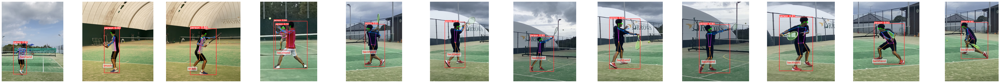

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt

import torch

# Specify the path to your image directory
image_directory = '/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/output/unknown/'

# List all image files in the directory
image_files = [f for f in os.listdir(image_directory) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Determine the number of images
num_images = len(image_files)

# Create a figure with subplots in a horizontal layout
fig, axes = plt.subplots(1, num_images, figsize=(num_images * 5, 5))

# If there's only one image, axes will not be an array, so we put it in one
if num_images == 1:
    axes = [axes]
i = 0
# Loop over the image files and display each one in a subplot
for ax, image_file in zip(axes, image_files):
    image_path = os.path.join(image_directory, image_file)
    image = Image.open(image_path)

    x, y = 244.5000, 773.0000
    # ラベルを枠の近くに配置
    ax.text(x, y - 10, predicted_label[i], fontsize=12, color='red', bbox=dict(facecolor='white', alpha=0.5))

    ax.imshow(image)
    ax.axis('off')  # Hide the axes
    i += 1

plt.tight_layout()
plt.show()

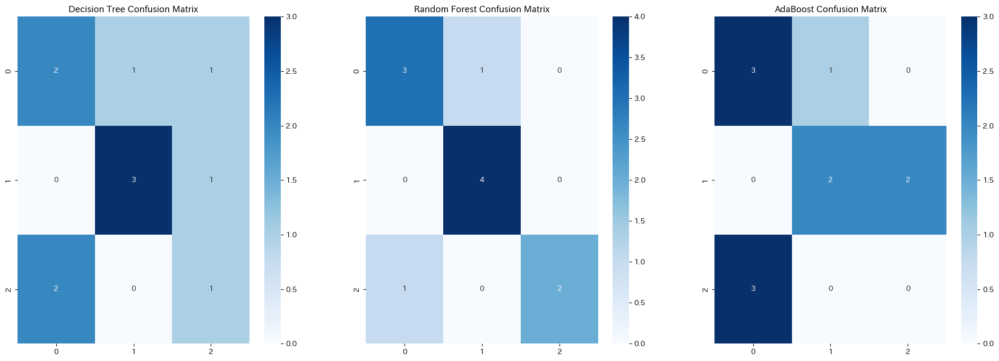

Decision Tree Model Report:
              precision    recall  f1-score   support

           0       0.50      0.50      0.50         4
           1       0.75      0.75      0.75         4
           2       0.33      0.33      0.33         3

    accuracy                           0.55        11
   macro avg       0.53      0.53      0.53        11
weighted avg       0.55      0.55      0.55        11


Random Forest Model Report:
              precision    recall  f1-score   support

           0       0.75      0.75      0.75         4
           1       0.80      1.00      0.89         4
           2       1.00      0.67      0.80         3

    accuracy                           0.82        11
   macro avg       0.85      0.81      0.81        11
weighted avg       0.84      0.82      0.81        11


AdaBoost Model Report:
              precision    recall  f1-score   support

           0       0.50      0.75      0.60         4
           1       0.67      0.50      0.57     

In [ ]:
# データの読み込み
url = "/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/csv_data/shot_eda_data_serve.csv"  # ここにCSVファイルのパスを指定します
data = pd.read_csv(url)

# 特徴量とターゲットにデータを分割
X = data.drop('shot', axis=1)
y = data['shot']

# ラベルを数値にエンコード
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# 訓練セットとテストセットに分割
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42)

# モデルを初期化
dt_classifier = DecisionTreeClassifier(random_state=42)
rf_classifier = RandomForestClassifier(random_state=42)
ab_classifier = AdaBoostClassifier(random_state=42)

# モデルを訓練
dt_classifier.fit(X_train, y_train)
rf_classifier.fit(X_train, y_train)
ab_classifier.fit(X_train, y_train)

# テストセットでモデルを評価
dt_predictions = dt_classifier.predict(X_test)
rf_predictions = rf_classifier.predict(X_test)
ab_predictions = ab_classifier.predict(X_test)

# 評価結果を表示
dt_report = classification_report(y_test, dt_predictions)
rf_report = classification_report(y_test, rf_predictions)
ab_report = classification_report(y_test, ab_predictions)

# 混合行列を計算
dt_cm = confusion_matrix(y_test, dt_predictions)
rf_cm = confusion_matrix(y_test, rf_predictions)
ab_cm = confusion_matrix(y_test, ab_predictions)

# 混合行列のヒートマップを描画
fig, axes = plt.subplots(1, 3, figsize=(24, 8))
sns.heatmap(dt_cm, annot=True, fmt="d", ax=axes[0], cmap="Blues")
sns.heatmap(rf_cm, annot=True, fmt="d", ax=axes[1], cmap="Blues")
sns.heatmap(ab_cm, annot=True, fmt="d", ax=axes[2], cmap="Blues")
axes[0].set_title('Decision Tree Confusion Matrix')
axes[1].set_title('Random Forest Confusion Matrix')
axes[2].set_title('AdaBoost Confusion Matrix')
plt.show()

# 評価レポートを表示
print("Decision Tree Model Report:")
print(dt_report)
print("\nRandom Forest Model Report:")
print(rf_report)
print("\nAdaBoost Model Report:")
print(ab_report)

In [ ]:
# 必要なライブラリのインポート
import pandas as pd
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import LabelEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier

# データの読み込み
url = "/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/csv_data/shot_eda_data.csv"  # ここにCSVファイルのパスを指定します
data = pd.read_csv(url)

# 特徴量とターゲットにデータを分割
X = data.drop('shot', axis=1)
y = data['shot']

# ラベルを数値にエンコード
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# モデルを初期化
dt_classifier = DecisionTreeClassifier(random_state=42)
rf_classifier = RandomForestClassifier(random_state=42)
ab_classifier = AdaBoostClassifier(random_state=42)

# 10回のクロスバリデーションを実行し、各分割におけるスコアを計算
dt_cv_scores = cross_val_score(dt_classifier, X, y_encoded, cv=10)
rf_cv_scores = cross_val_score(rf_classifier, X, y_encoded, cv=10)
ab_cv_scores = cross_val_score(ab_classifier, X, y_encoded, cv=10)

# クロスバリデーションの結果を出力
print("Decision Tree 10-fold CV Accuracy: %0.2f (+/- %0.2f)" % (dt_cv_scores.mean(), dt_cv_scores.std() * 2))
print("Random Forest 10-fold CV Accuracy: %0.2f (+/- %0.2f)" % (rf_cv_scores.mean(), rf_cv_scores.std() * 2))
print("AdaBoost 10-fold CV Accuracy: %0.2f (+/- %0.2f)" % (ab_cv_scores.mean(), ab_cv_scores.std() * 2))

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 9 members, which is less than n_splits=10.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 9 members, which is less than n_splits=10.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 9 members, which is less than n_splits=10.
  warnings.warn(


Decision Tree 10-fold CV Accuracy: 0.71 (+/- 0.21)
Random Forest 10-fold CV Accuracy: 0.85 (+/- 0.22)
AdaBoost 10-fold CV Accuracy: 0.42 (+/- 0.41)


In [ ]:
import numpy as np

def linear_interpolation(arr):
    """
    1D配列内の0を線形補完する関数。

    Parameters:
    - arr: 1D numpy配列。

    Returns:
    - 補完後の1D numpy配列。
    """

    # 0以外の有効なインデックスを取得
    valid_idx = np.where(arr != 0)[0]

    # 0以外の有効な値を取得
    valid_values = arr[valid_idx]

    # 線形補完
    interpolated = np.interp(range(len(arr)), valid_idx, valid_values)

    return interpolated

def plot_keypoints(result_list):
    """
    X座標とY座標の正規化された骨格キーポイントを表示する関数。

    Parameters:
    - result_list: 各画像の骨格検出結果を格納するリスト。
    """

    # 各画像の正規化された骨格のキーポイントの x, y 座標を取得
    # x_coords = [result[0].keypoints.xyn[0][:, 0].numpy() for result in result_list]
    # y_coords = [result[0].keypoints.xyn[0][:, 1].numpy() for result in result_list]

    # 各画像の正規化された骨格のキーポイントの x, y 座標を取得（0を線形補間）
    x_coords = [linear_interpolation(result[0].keypoints.xyn[0][:, 0].cpu().numpy()) for result in result_list]
    y_coords = [linear_interpolation(result[0].keypoints.xyn[0][:, 1].cpu().numpy()) for result in result_list]


    # 部位の名前
    keypoints_names = ['左肩', '右肩', '左肘', '右肘', '左手首', '右手首']

    # 画像の数を取得
    num_images = len(result_list)

    # lists = []
    # for i in range(15):
    #   sub_list = []  # Create a new sublist for each iteration of i
    #   for j in range(6):
    #     sub_list.append(x_coords[i][j+5])
    #     sub_list.append(y_coords[i][j+5])
    # sub_list.append(shot)
    # lists.append(sub_list)  # Append the sublist to the main list

    # data = pd.DataFrame(data=lists, columns=columns_name)

    # グラフの表示
    fig, axarr = plt.subplots(1, 2, figsize=(24, 6))  # 2つの横並びのグラフ

    # X座標の折れ線グラフの作成
    image_indices = range(num_images)
    for i, name in enumerate(keypoints_names):  # 6 keypoints
        axarr[0].plot(image_indices, [x[i+5] for x in x_coords], label=name)
    axarr[0].set_xlabel('Image Index')
    axarr[0].set_ylabel('Normalized X Coordinate')
    axarr[0].set_title('Normalized X Keypoint Coordinates per Image')
    axarr[0].set_xticks(image_indices)
    axarr[0].legend(loc='upper left', bbox_to_anchor=(1, 1), ncol=1)
    axarr[0].grid(True)

    # Y座標の折れ線グラフの作成
    for i, name in enumerate(keypoints_names):  # 6 keypoints
        axarr[1].plot(image_indices, [y[i+5] for y in y_coords], label=name)
    axarr[1].set_xlabel('Image Index')
    axarr[1].set_ylabel('Normalized Y Coordinate')
    axarr[1].set_title('Normalized Y Keypoint Coordinates per Image')
    axarr[1].set_xticks(image_indices)
    axarr[1].legend(loc='upper left', bbox_to_anchor=(1, 1), ncol=1)
    axarr[1].grid(True)

    plt.tight_layout()
    plt.show()

# Note: 関数内で線形補完関数を適用して、0のキーポイントを補完しています。


In [ ]:
import os
import matplotlib.pyplot as plt

def display_images_from_directory(directory_path):
    """
    指定したディレクトリ内の画像を横並びに表示する関数。

    Parameters:
    - directory_path: 画像が格納されているディレクトリのパス。
    """

    # 指定されたディレクトリ内の画像ファイルのリストを取得
    image_files = sorted([f for f in os.listdir(directory_path) if f.endswith(('.png', '.jpg', '.jpeg'))])

    # 画像の数を取得
    num_images = len(image_files)

    # 画像の表示
    plt.figure(figsize=(3 * num_images, 5))
    for idx, image_file in enumerate(image_files):
        img_path = os.path.join(directory_path, image_file)
        img = plt.imread(img_path)

        # 画像のプロット
        plt.subplot(1, num_images, idx + 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title(f'Index: {idx}')  # インデックスをタイトルとして追加

    plt.tight_layout()
    plt.show()

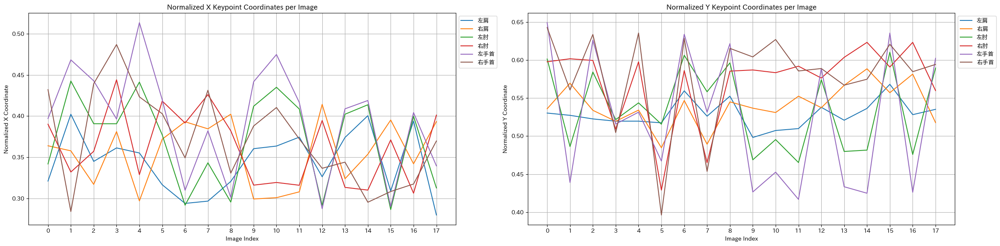

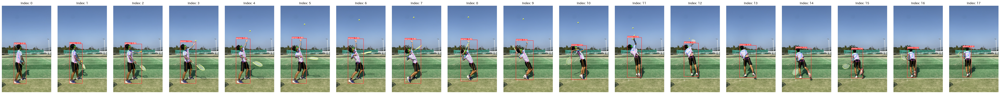

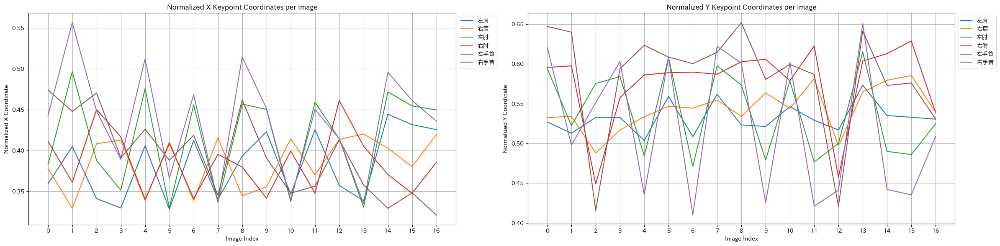

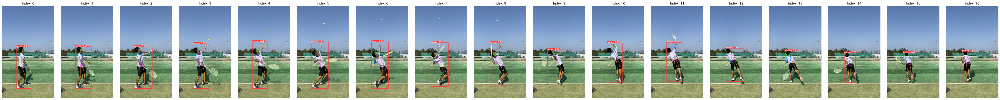

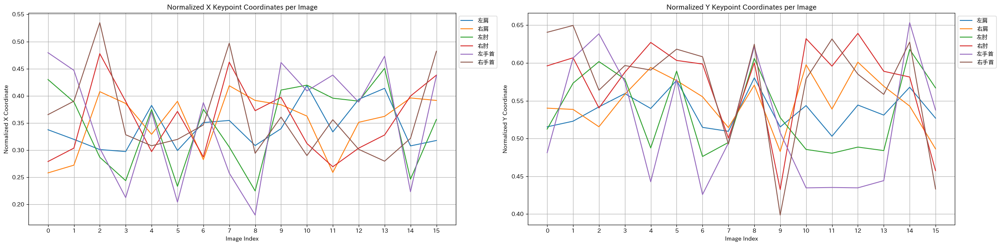

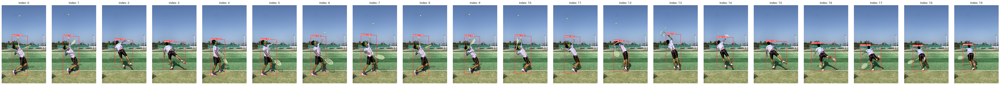

In [ ]:
for shot in serve_shots:
  plot_keypoints(results[shot], shot)
  display_images_from_directory(f"/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/output/{shot}/")

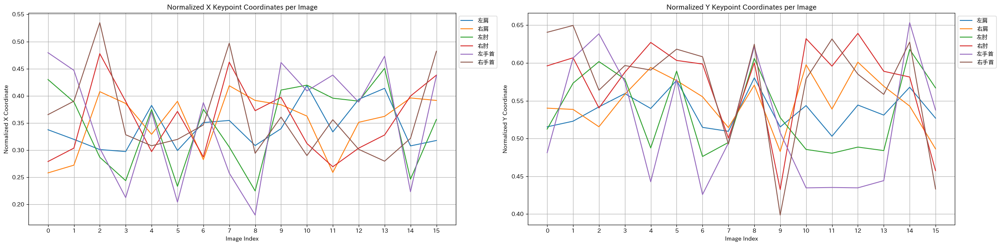

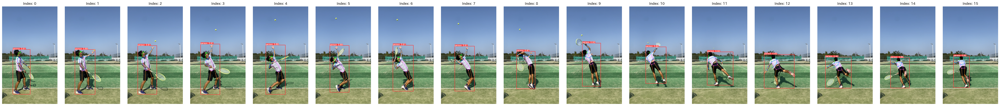

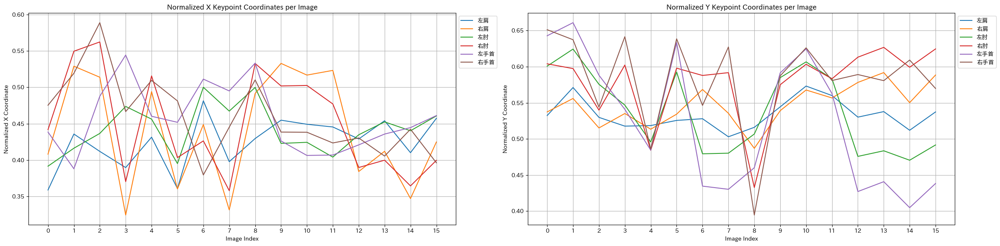

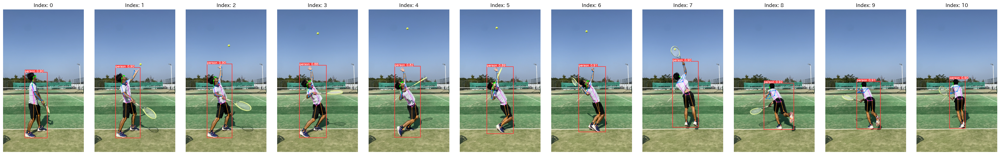

In [ ]:
plot_keypoints(results["spin_in"], "spin_in")
display_images_from_directory("/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/output/spin_in/")
plot_keypoints(results["spin_in2"], "spin_in2")
display_images_from_directory("/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/output/spin_in2/")

In [ ]:
filename_in = '/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/input/video/IMG_7433.mov'
filename_out = '/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/output/'

In [ ]:
import cv2
import os
from ultralytics import YOLO

def process_video(video_path, output_path):
    """
    動画に骨格検出モデルを適用し、結果を保存する関数。

    Parameters:
    - video_path: 動画ファイルのパス。
    - output_path: 結果を保存するディレクトリのパス。

    Returns:
    - None
    """

    # モデルの読み込み
    model = YOLO("yolov8n-pose.pt")

    # 動画キャプチャの初期化
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print("Error: Could not open video.")
        return

    # 出力ディレクトリが存在しない場合は作成
    os.makedirs(output_path, exist_ok=True)

    # 動画のフレームごとに処理
    frame_num = 0
    while True:
        # フレームの読み込み
        ret, frame = cap.read()
        if not ret:
            break

        # モデルの適用
        result = model(frame)

        # 結果のフレームに描画
        plotted_frame = result[0].plot()

        # 結果をファイルに保存
        output_file = os.path.join(output_path, f"frame_{frame_num:04d}.jpg")
        cv2.imwrite(output_file, plotted_frame)

        frame_num += 1

    # 動画キャプチャのリリース
    cap.release()

# この関数を呼び出して動画の処理を実行
    # 動画ファイル
# 物体検出関数を実行
# process_video(filename_in, filename_out)

In [ ]:
import cv2
import os
from ultralytics import YOLO

def process_video(video_path, output_path):
    # モデルの読み込み
    model = YOLO("yolov8n-pose.pt")

    # 動画キャプチャの初期化
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print("Error: Could not open video.")
        return

    # 動画のフレームレートとサイズを取得
    fps = cap.get(cv2.CAP_PROP_FPS)
    print("fps:" , fps)
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # 出力動画ファイルの設定
    output_filename = os.path.join(output_path, 'processed_video_ando_fore.mp4')
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_filename, fourcc, fps, (frame_width, frame_height))

    # 各画像の結果を格納するリスト
    results_list = []

    while True:
        # フレームの読み込み
        ret, frame = cap.read()
        if not ret:
            break

        # モデルの適用
        result = model(frame)

        results_list.append(result)

        # 結果のフレームに描画
        plotted_frame = result[0].plot()

        # 処理されたフレームを動画ファイルに書き出す
        out.write(plotted_frame)

    # リソースの解放
    cap.release()
    out.release()

    return results_list

In [ ]:
result = process_video(filename_in, filename_out)

fps: 30.0



0: 384x640 2 persons, 19.1ms
Speed: 3.3ms preprocess, 19.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 45.8ms
Speed: 2.9ms preprocess, 45.8ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 27.3ms
Speed: 3.2ms preprocess, 27.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 20.3ms
Speed: 2.9ms preprocess, 20.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 18.0ms
Speed: 2.9ms preprocess, 18.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 12.0ms
Speed: 2.8ms preprocess, 12.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 21.3ms
Speed: 4.0ms preprocess, 21.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 12.8ms
Speed: 3.3ms preprocess, 12.8ms inference, 2.3ms postprocess per image at shape (1, 3, 

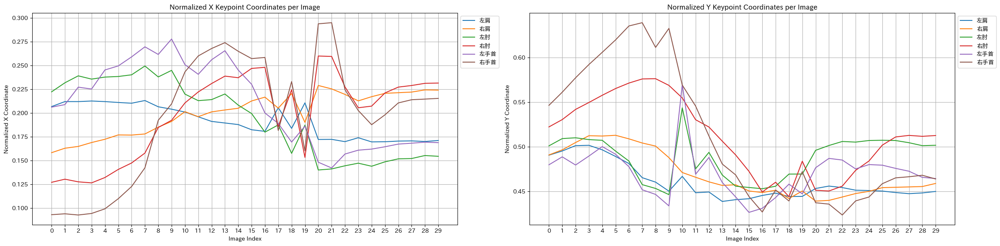

In [ ]:
plot_keypoints(result)

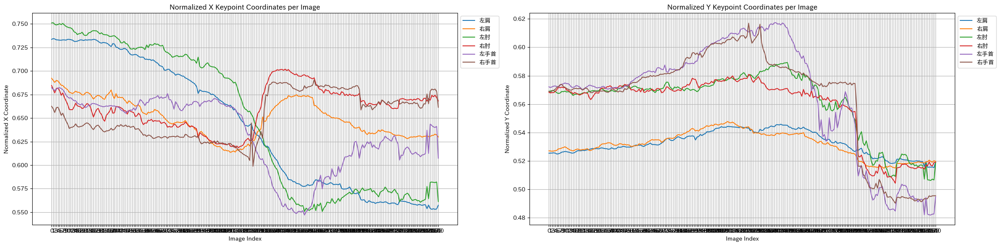

In [ ]:
plot_keypoints(result)

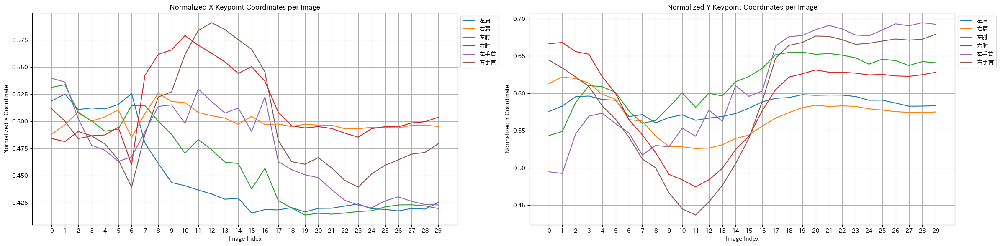

In [ ]:
plot_keypoints(result)

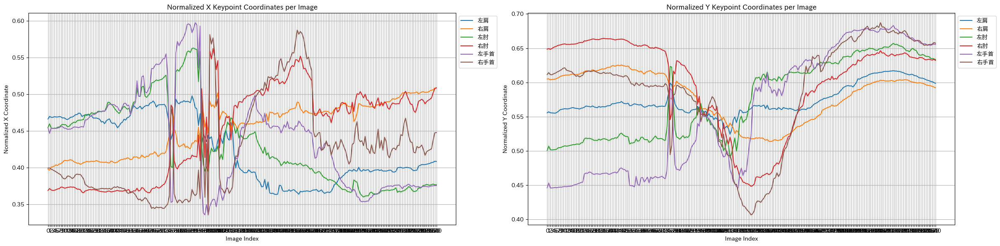

In [ ]:
plot_keypoints(result)

In [ ]:
import cv2
import os
from google.colab import files
from pathlib import Path

# 必要なライブラリがインストールされているかを確認し、なければインストールする
!pip install opencv-python-headless

In [ ]:
# ファイルをアップロードする関数
def upload_files():
    uploaded = files.upload()
    return uploaded.keys()

# 動画ファイルをアップロード
video_files = upload_files()

# 各動画ファイルごとに処理
for video_file in video_files:
    # 動画ファイル名から拡張子を取り除き、それを出力フォルダ名に使用
    output_folder_name = Path(video_file).stem
    output_folder = Path('/content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/input/shots_variable/backvolly')
    output_folder.mkdir(parents=True, exist_ok=True)

    # 動画を開く
    cap = cv2.VideoCapture(video_file)
    frame_num = 0

    while True:
        # フレームを読み込む
        ret, frame = cap.read()
        if not ret:
            break  # フレームの読み込みに失敗したら終了

        # フレームを画像として保存
        frame_path = output_folder / f'frame_fede_bv2_{frame_num:04d}.png'
        cv2.imwrite(str(frame_path), frame)

        frame_num += 1

    # 動画キャプチャを解放
    cap.release()

    print(f'Finished extracting frames to {output_folder}.')

Saving 画面収録 2023-11-17 22.03.21.mov to 画面収録 2023-11-17 22.03.21.mov
Finished extracting frames to /content/drive/MyDrive/Colab_Notebooks/ML_Day2_code/input/shots_variable/backvolly.
